# Overview

* Estimativa de profundidade monocular auto-supervisionada (Monodepth2) constrói um modelo de profundidade simples e o treina de maneira auto-supervisionada, explorando a restrição da geometria espacial.

* Uma arquitetura U-Net simples é usada no Monoprofundidade2, que combina vários recursos de escala com diferentes tamanhos de campo receptivo. Ele agrupa os mapas de recursos em tamanhos diferentes e, em seguida, concatena-os após o aumento da resolução. Existem dois decodificadores para estimativa de profundidade e estimativa de pose da câmera.


## Paper citation

> **Digging into Self-Supervised Monocular Depth Prediction**
>
> [Clément Godard](http://www0.cs.ucl.ac.uk/staff/C.Godard/), [Oisin Mac Aodha](http://vision.caltech.edu/~macaodha/), [Michael Firman](http://www.michaelfirman.co.uk) and [Gabriel J. Brostow](http://www0.cs.ucl.ac.uk/staff/g.brostow/)
>
> [ICCV 2018](https://arxiv.org/abs/1806.01260)

```
@article{monodepth2,
  title     = {Digging into Self-Supervised Monocular Depth Prediction},
  author    = {Cl{\'{e}}ment Godard and
               Oisin {Mac Aodha} and
               Michael Firman and
               Gabriel J. Brostow},
  booktitle = {The International Conference on Computer Vision (ICCV)},
  month = {October},
year = {2019}
}
```

Links uteis: https://github.com/nianticlabs/monodepth2, https://github.com/FangGet/tf-monodepth2


# 1. Importe de bibliotecas

In [ ]:
import tensorflow as tf
import torch
import tensorflow.keras.layers as layers

# 2. Carregando os pesos e bias já treinados para a rede convolucional:

*   encoder.pth
*   decoder.pth
*   pose.pth
*   pose-encoder.pth


In [ ]:
!wget https://storage.googleapis.com/niantic-lon-static/research/monodepth2/mono_640x192.zip

!unzip mono_640x192.zip


encoder_path = 'encoder.pth'
decoder_path = 'depth.pth'

loaded_dict_enc = torch.load(encoder_path, map_location='cpu')
loaded_dict = torch.load(decoder_path, map_location='cpu')

--2024-07-04 01:19:20--  https://storage.googleapis.com/niantic-lon-static/research/monodepth2/mono_640x192.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 142.251.179.207, 64.233.180.207, 172.253.62.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|142.251.179.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 103531333 (99M) [application/zip]
Saving to: ‘mono_640x192.zip’

mono_640x192.zip    100%[===================>]  98.73M  23.0MB/s    in 4.9s    

2024-07-04 01:19:25 (20.3 MB/s) - ‘mono_640x192.zip’ saved [103531333/103531333]

Archive:  mono_640x192.zip
  inflating: depth.pth               
  inflating: encoder.pth             
  inflating: pose.pth                
  inflating: pose_encoder.pth        


## 3. Métodos auxiliares

* O Reflection Padding é usado em processamento de imagem e redes neurais convolucionais para criar uma borda espelhada ao redor da imagem original. Isso preserva detalhes e bordas importantes durante convoluções e operações similares, reduzindo artefatos e vazamento de informação nas bordas da imagem. É especialmente útil para manter a consistência e a precisão das características espaciais, melhorando a qualidade geral das saídas da rede neural.

In [ ]:
class ReflectionPadding2D(tf.keras.layers.Layer):
    # Defining a reflection pad layer for keras
    def __init__(self, padding=(1, 1), **kwargs):
        self.padding = tuple(padding)
        self.input_spec = [tf.keras.layers.InputSpec(ndim=4)]
        super(ReflectionPadding2D, self).__init__(**kwargs)

    def compute_output_shape(self, s):
        return (s[0], s[1] + 2 * self.padding[0], s[2] + 2 * self.padding[1], s[3])

    def call(self, x, mask=None):
        w_pad, h_pad = self.padding
        return tf.pad(x, [[0, 0], [h_pad, h_pad], [w_pad, w_pad], [0, 0]], 'REFLECT')

    def get_config(self):
        config = super().get_config().copy()
        return config

class Util():
    def __init__(self):
          self = self
    def resize_img(self, img):
      img['image'] = tf.image.resize(img['image'],[192,640])
      return img['image']/255.

    def resize_img2(self, img):
      img['image'] = tf.image.resize(img['image'],[512,512])
      return img['image']/255.

    def load_and_preprocess_image(file_path):
      image = tf.io.read_file(file_path)
      image = tf.image.decode_jpeg(image, channels=3)
      image = resize_img(image)
      image = image / 255.0  # Normaliza as imagens entre 0 e 1
      return image

# 4. Modelos e DepthEstimation

## 4.1. Camada de ResNet

* A camada ResNet no MonoDepth2 é essencial para permitir que o modelo de estimativa de profundidade monoocular aprenda representações hierárquicas complexas das imagens. Utilizando conexões residuais, a ResNet facilita o treinamento de redes mais profundas, mitigando problemas como desaparecimento de gradiente e melhorando a eficiência computacional. Isso resulta em estimativas mais precisas de profundidade a partir de imagens únicas, adaptando-se bem a diferentes contextos visuais e promovendo uma melhor generalização do modelo para aplicações práticas em visão computacional.

## 4.2. Camada Convolucional

* A Camada convolucional em redes neurais começa com a aplicação de filtros para capturar padrões locais na entrada. As ativações resultantes passam por funções não-lineares como ReLU. O pooling reduz a dimensionalidade preservando características importantes. Este processo se repete para aprender características complexas e abstratas. Finalmente, a saída é gerada após camadas densas e regularização para melhorar o desempenho e a precisão da rede.

* O Upsampling é uma técnica essencial em redes neurais e processamento de imagem, usada para aumentar a resolução de feature maps. Ele restaura detalhes perdidos durante o downsampling e é crucial para tarefas como segmentação semântica e geração de imagens de alta qualidade. Métodos como interpolação bilinear e convolução transposta são comuns para realizar o Upsampling, garantindo que as redes neurais preservem precisão e detalhes espaciais em suas saídas.

## 4.3. Fluxo de Encoder

* O encoder em redes neurais convolucionais converte a entrada, como imagens, em representações de características abstratas através de camadas convolucionais e pooling. Ele comprime e extrai informações relevantes, formando uma base crucial para tarefas complexas como reconhecimento de padrões e segmentação de imagem.

## 4.4. Fluxo de Decoder
* O decoder em redes neurais convolucionais recebe as representações de características de baixa resolução do encoder e utiliza operações de upsampling para reconstruir uma saída detalhada de alta resolução. Ele aplica convoluções para combinar e refinar as features upsampladas, seguido por ativações e normalização para melhorar a precisão e estabilidade. O resultado final é a saída reconstruída que corresponde à tarefa específica do modelo, como segmentação de imagem ou geração de imagem.

In [ ]:
class DepthEstimation():
  def __init__(self):
        self = self

  def ResNetBlock(self, inputs, layer, downsample=False):
    filters = inputs.shape[-1]
    filters *= 2 if downsample else 1
    strides = 2 if downsample else 1
    name = 'en.layer' + str(layer[0]) + '.' + str(layer[1]) + '.'

    featureZeroPaddingA = layers.ZeroPadding2D(1)(inputs)
    featureConvA = layers.Conv2D(filters, 3, activation='linear', use_bias=False, strides=strides, name=name + 'conv1')(featureZeroPaddingA)
    featureNormalizationA = layers.BatchNormalization(momentum=0.9, epsilon=1e-5, name=name + 'bn1')(featureConvA)
    featureReLuA = layers.ReLU()(featureNormalizationA)
    featureZeroPaddingB = layers.ZeroPadding2D(1)(featureReLuA)
    featureConvB = layers.Conv2D(filters, 3, activation='linear', use_bias=False, name=name + 'conv2')(featureZeroPaddingB)
    featureNormalizationB = layers.BatchNormalization(momentum=0.9, epsilon=1e-5, name=name + 'bn2')(featureConvB)

    if not downsample:
        add = featureNormalizationB + inputs
    else:
        name += 'downsample.'
        featureConvC = layers.Conv2D(filters, 1, activation='linear',
                       use_bias=False, strides=2, name=name + '0')(inputs)
        featureNormalizationC = layers.BatchNormalization(momentum=0.9, epsilon=1e-5, name=name + '1')(featureConvC)
        add = featureNormalizationB + featureNormalizationC

    featureReLuB = layers.ReLU()(add)
    return featureReLuB

  def ConvolutionBlock(self, size, inTensor, disp=False, cnt=''):
    name = 'dispconv' if disp else 'upconv'
    name = 'de.' + name + '.' + str(len("{0:b}".format(size)) - 5) + '.' + cnt
    filters = 1 if disp else size
    x = ReflectionPadding2D()(inTensor)
    x = tf.keras.layers.Conv2D(filters, 3, name=name)(x)
    if not disp:
        x = tf.keras.layers.ELU()(x)
    else:
        x = tf.keras.activations.sigmoid(x)
    return x

  def UpSampling(self, size, firstTensor, secondTensor=None):
    x = self.ConvolutionBlock(size, firstTensor, cnt='0')
    x = tf.keras.layers.UpSampling2D()(x)
    if size > 16:
        x = tf.keras.layers.concatenate([x, secondTensor], axis=-1)
    x = self.ConvolutionBlock(size, x, cnt='1')
    return x

  def Encoder(self, inputs, encoder):
    inputs = (inputs - 0.45) / 0.225
    featureZeroPaddingA = layers.ZeroPadding2D(3)(inputs)
    featureConvA = layers.Conv2D(64, 7, strides=2, activation='linear', use_bias=False, name='conv1')(featureZeroPaddingA)
    featureNormalizationA = layers.BatchNormalization(momentum=0.9, epsilon=1e-5, name='bn1')(featureConvA)
    featureReLuA = layers.ReLU()(featureNormalizationA)
    encoder.append(featureReLuA)
    featureZeroPaddingB = layers.ZeroPadding2D(1)(featureReLuA)
    feature = layers.MaxPooling2D(3, 2)(featureZeroPaddingB)
    for i in range(1, 5):
      feature = self.ResNetBlock(feature, (i, 0), i > 1)
      feature = self.ResNetBlock(feature, (i, 1))
      encoder.append(feature)
    return encoder

  def Decoder(self, encoder, outputs):
    feature = self.UpSampling(256, encoder[4], encoder[3])
    feature = self.UpSampling(128, feature, encoder[2])
    outputs.append(self.ConvolutionBlock(128, feature, disp=True))
    feature = self.UpSampling(64, feature, encoder[1])
    outputs.append(self.ConvolutionBlock(64, feature, disp=True))
    feature = self.UpSampling(32, feature, encoder[0])
    outputs.append(self.ConvolutionBlock(32, feature, disp=True))
    feature = self.UpSampling(16, feature)
    outputs.append(self.ConvolutionBlock(16, feature, disp=True))
    outputs = outputs[::-1]
    return outputs

  def Model(self, inputs, outputs):
     model = tf.keras.Model(inputs=inputs, outputs=outputs, name='depth')
     model.get_layer('conv1').set_weights(
         [loaded_dict_enc['encoder.conv1.weight'].numpy().transpose(2, 3, 1, 0)])
     model.get_layer('bn1').set_weights(
         [loaded_dict_enc['encoder.bn1.weight'].numpy(),
          loaded_dict_enc['encoder.bn1.bias'].numpy(),
          loaded_dict_enc['encoder.bn1.running_mean'].numpy(),
          loaded_dict_enc['encoder.bn1.running_var'].numpy()])
     for layer in model.layers:
       name = layer.name.split('.')
       if name[0] == 'en':
         name = '.'.join(name[1:])
         num_weights = len(layer.get_weights())
         if num_weights == 1:
           layer.set_weights([loaded_dict_enc['encoder.' + name + '.weight'].numpy().transpose(2, 3, 1, 0)])
         else:
           layer.set_weights(
               [loaded_dict_enc['encoder.' + name + '.weight'].numpy(),
                loaded_dict_enc['encoder.' + name + '.bias'].numpy(),
                loaded_dict_enc['encoder.' + name + '.running_mean'].numpy(),
                loaded_dict_enc['encoder.' + name + '.running_var'].numpy()])

       if name[0] == 'de':
         if name[1] == 'upconv':
           num = str(2 * (4 - int(name[2])) + int(name[3]))
           layer.set_weights([loaded_dict['decoder.' + num + '.conv.conv.weight']
                              .numpy().transpose(2, 3, 1, 0),
                              loaded_dict['decoder.' + num + '.conv.conv.bias'].numpy()])
         else:
           num = str(int(name[2]) + 10)
           layer.set_weights([loaded_dict['decoder.' + num + '.conv.weight']
                              .numpy().transpose(2, 3, 1, 0),
                              loaded_dict['decoder.' + num + '.conv.bias'].numpy()])
     return model


# 5. Conectar com Google Drive e Carregar as fotos de testes a executar o modelo com as fotos extraídas nos experimentos

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import os
import matplotlib.pyplot as plt
from google.colab import drive


# Caminho das imagens no Google Drive
image_path = '/content/drive/MyDrive/fotos/photos/'

# Lista de arquivos de imagem
image_files = [os.path.join(image_path, f) for f in os.listdir(image_path) if f.endswith('.jpg')]

# Carrega e preprocessa as imagens
input_images = [load_and_preprocess_image(f) for f in image_files[:20]]  # Carrega apenas as primeiras 32 imagens
input_images = tf.stack(input_images)  # Empilha em um tensor

Mounted at /content/drive


# 6. Método de Execução do Modelo
* Carrega as saidas e entradas do modelo (encoder e decoder)


In [ ]:
# Faz a predição no lote de imagens
inputs = layers.Input(shape=(192,640,3))
encoder = []
outputs = []
encoder = DepthEstimation().Encoder(inputs, encoder)
outputs = DepthEstimation().Decoder(encoder, outputs)
model = DepthEstimation().Model(inputs, outputs)

# 7. Executa a predição das imagens carregadas e imprimi os resultados lado a lado


1/1 [==============================] - 10s 10s/step


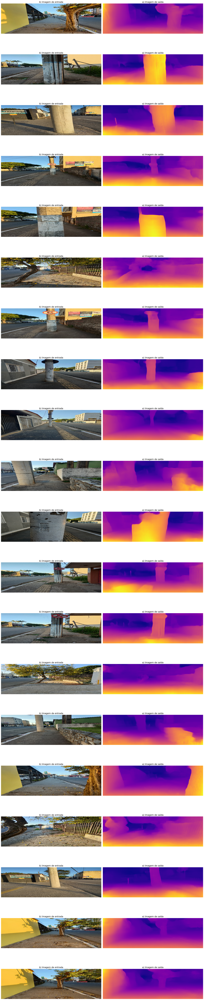

In [ ]:
import matplotlib.pyplot as plt

# Faz a predição no lote de imagens
result_img = model.predict(input_images)

# Configurar subplots para 20 linhas e 2 colunas
fig, axes = plt.subplots(20, 2, figsize=(20, 100))

# Iterar sobre as primeiras 20 imagens
for i in range(20):
    # Número da imagem no lote que queremos visualizar
    val = i

    imin = input_images[val]
    imout = result_img[0][val].reshape(192, 640)  # Ajustar a forma da imagem de saída

     # Mostrar a imagem de entrada com legenda
    axes[i, 0].imshow(imin)
    axes[i, 0].set_title(f'b) Imagem de entrada {val}', fontsize=15)
    axes[i,0].axis('off')  # Ocultar os eixos

    # Mostrar a imagem de saída com legenda
    axes[i, 1].imshow(imout)  # Supondo que a saída seja uma imagem em escala de cinza
    axes[i, 1].set_title(f'a) Imagem de saída {val}', fontsize=15)
    axes[i, 1].axis('off')  # Ocultar os eixos


# Ajustar o layout para evitar sobreposição de títulos
plt.tight_layout()

# Exibir as imagens
plt.show()


# 8. Reeconstrução da imagem em 3D usando a biblioteca da OpenCv

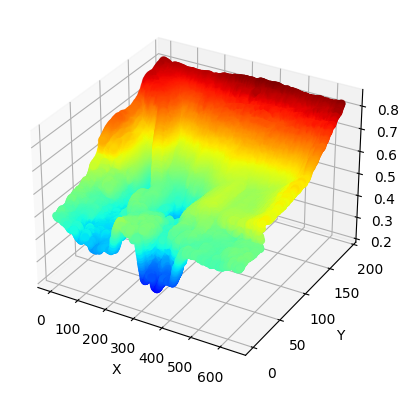

In [ ]:
import cv2
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

# Função para calcular as coordenadas 3D
def calculate_3d_coordinates(image_coordinates, depth, camera_matrix, distortion_coeffs):
    # Adicionar o valor de profundidade às coordenadas de imagem
    image_coordinates_depth = np.array([[image_coordinates[0], image_coordinates[1]]], dtype=np.float32)

    # Corrigir as coordenadas de imagem usando os coeficientes de distorção
    undistorted_coordinates = cv2.undistortPoints(image_coordinates_depth, camera_matrix, distortion_coeffs, P=camera_matrix)
    # Multiplicar as coordenadas corrigidas pela profundidade para obter as coordenadas 3D
    coordinates_3d = np.append(undistorted_coordinates[0][0], depth)
    return coordinates_3d

# Carregar a matriz da câmera e os coeficientes de distorção
camera_matrix = np.array([[2.95389836e+03, 0.00000000e+00, 1.59195353e+03],
                          [0.00000000e+00, 2.60746459e+03, 1.28217291e+03],
                          [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]])

distortion_coeffs = np.array([[-0.56239355, 0.25599173, 0.16078187, 0.01695844, -0.17199612]])

depth_map = imout
image_height, image_width = depth_map.shape
valid_coordinates = []

for y in range(image_height):
    for x in range(image_width):
        depth = depth_map[y, x]

        if 0 <= depth <= 1:
            image_coordinates = (x, y)
            coordinates_3d = calculate_3d_coordinates(image_coordinates, depth, camera_matrix, distortion_coeffs)

            valid_coordinates.append(coordinates_3d)

valid_coordinates = np.array(valid_coordinates)

# Escala logarítmica para ajustar a profundidade
valid_coordinates[:, 2] = np.log10(valid_coordinates[:, 2] * 10 + 1)

# Plotagem da imagem 3D
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(valid_coordinates[:, 0], valid_coordinates[:, 1], valid_coordinates[:, 2], c=valid_coordinates[:, 2], cmap='jet')
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')


plt.show()


In [ ]:
import plotly.graph_objects as go

# Dados das coordenadas
x = valid_coordinates[:, 0]
y = valid_coordinates[:, 1]
z = valid_coordinates[:, 2]

# Criação da figura 3D
fig = go.Figure(data=[go.Scatter3d(x=x, y=y, z=z, mode='markers',
                                   marker=dict(color=z, colorscale='Viridis', cmin=min(z), cmax=max(z)))])
# Configuração dos eixos
fig.update_layout(scene=dict(
    xaxis_title='X',
    yaxis_title='Y',
    zaxis_title='Z'
))

# Exibição da figura
fig.show()


# 9. Salva o modelo em TensorFlow

In [ ]:
inputs = layers.Input(shape=(192,640,3))
encoder = []
outputs = []
encoder = DepthEstimation().Encoder(inputs, encoder)
outputs = DepthEstimation().Decoder(encoder, outputs)
model = DepthEstimation().Model(inputs, outputs)

path = '/content/tf'
tf.saved_model.save(model, path)
modelPreFinal = tf.saved_model.load(path)

# 10. Converte o modelo TensorFlow para TensorFlow Lite

In [ ]:
# Convert the model
converter = tf.lite.TFLiteConverter.from_saved_model(path) # path to the SavedModel directory
tflite_model = converter.convert()

# Save the model.
with open('model_alfa.tflite', 'wb') as f:
  f.write(tflite_model)

# 11. Valida o modelo gerado em TensorFlow Lite

In [ ]:
TFLITE_MODEL = "model_alfa.tflite"

interpreter = tf.lite.Interpreter(model_path=TFLITE_MODEL)
interpreter.allocate_tensors()
print("== Input details ==")
print("name:", interpreter.get_input_details()[0]['name'])
print("shape:", interpreter.get_input_details()[0]['shape'])
print("type:", interpreter.get_input_details()[0]['dtype'])

print("\nDUMP INPUT")
print(interpreter.get_input_details()[0])

print("\n== Output details ==")
print("name:", interpreter.get_output_details()[0]['name'])
print("shape:", interpreter.get_output_details()[0]['shape'])
print("type:", interpreter.get_output_details()[0]['dtype'])

print("\nDUMP OUTPUT")
print(interpreter.get_output_details()[0])


== Input details ==
name: serving_default_input_3:0
shape: [  1 192 640   3]
type: <class 'numpy.float32'>

DUMP INPUT
{'name': 'serving_default_input_3:0', 'index': 0, 'shape': array([  1, 192, 640,   3], dtype=int32), 'shape_signature': array([ -1, 192, 640,   3], dtype=int32), 'dtype': <class 'numpy.float32'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=float32), 'zero_points': array([], dtype=int32), 'quantized_dimension': 0}, 'sparsity_parameters': {}}

== Output details ==
name: StatefulPartitionedCall:3
shape: [  1  48 160   1]
type: <class 'numpy.float32'>

DUMP OUTPUT
{'name': 'StatefulPartitionedCall:3', 'index': 155, 'shape': array([  1,  48, 160,   1], dtype=int32), 'shape_signature': array([ -1,  48, 160,   1], dtype=int32), 'dtype': <class 'numpy.float32'>, 'quantization': (0.0, 0), 'quantization_parameters': {'scales': array([], dtype=float32), 'zero_points': array([], dtype=int32), 'quantized_dimension': 0}, 'sparsity_parameters': {}}